<a href="https://colab.research.google.com/github/Mateorpo/senior-project/blob/main/Real_state_prediction_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [29]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import seaborn as sns


In [30]:
from google.colab import drive
drive.mount('/content/gdrive')


Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [31]:
dataset= 'gdrive/My Drive/senior project/realtor-data.zip.csv'


In [32]:
df=pd.read_csv(dataset)
df.head()

,brokered_by,status,price,bed,bath,acre_lot,street,city,state,zip_code,house_size,prev_sold_date
0,103378.0,for_sale,105000.0,3.0,2.0,0.12,1962661.0,Adjuntas,Puerto Rico,601.0,920.0,NaN
1,52707.0,for_sale,80000.0,4.0,2.0,0.08,1902874.0,Adjuntas,Puerto Rico,601.0,1527.0,NaN
2,103379.0,for_sale,67000.0,2.0,1.0,0.15,1404990.0,Juana Diaz,Puerto Rico,795.0,748.0,NaN
3,31239.0,for_sale,145000.0,4.0,2.0,0.10,1947675.0,Ponce,Puerto Rico,731.0,1800.0,NaN
4,34632.0,for_sale,65000.0,6.0,2.0,0.05,331151.0,Mayaguez,Puerto Rico,680.0,NaN,NaN


In [33]:
df.tail()

,brokered_by,status,price,bed,bath,acre_lot,street,city,state,zip_code,house_size,prev_sold_date
2226377,23009.0,sold,359900.0,4.0,2.0,0.33,353094.0,Richland,Washington,99354.0,3600.0,2022-03-25
2226378,18208.0,sold,350000.0,3.0,2.0,0.10,1062149.0,Richland,Washington,99354.0,1616.0,2022-03-25
2226379,76856.0,sold,440000.0,6.0,3.0,0.50,405677.0,Richland,Washington,99354.0,3200.0,2022-03-24
2226380,53618.0,sold,179900.0,2.0,1.0,0.09,761379.0,Richland,Washington,99354.0,933.0,2022-03-24
2226381,108243.0,sold,580000.0,5.0,3.0,0.31,307704.0,Richland,Washington,99354.0,3615.0,2022-03-23


In [34]:
df.describe()

,brokered_by,price,bed,bath,acre_lot,street,zip_code,house_size
count,2.221849e+06,2.224841e+06,1.745065e+06,1.714611e+06,1.900793e+06,2.215516e+06,2.226083e+06,1.657898e+06
mean,5.293989e+04,5.241955e+05,3.275841e+00,2.496440e+00,1.522303e+01,1.012325e+06,5.218668e+04,2.714471e+03
std,3.064275e+04,2.138893e+06,1.567274e+00,1.652573e+00,7.628238e+02,5.837635e+05,2.895408e+04,8.081635e+05
min,0.000000e+00,0.000000e+00,1.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,4.000000e+00
25%,2.386100e+04,1.650000e+05,3.000000e+00,2.000000e+00,1.500000e-01,5.063128e+05,2.961700e+04,1.300000e+03
50%,5.288400e+04,3.250000e+05,3.000000e+00,2.000000e+00,2.600000e-01,1.012766e+06,4.838200e+04,1.760000e+03
75%,7.918300e+04,5.500000e+05,4.000000e+00,3.000000e+00,9.800000e-01,1.521173e+06,7.807000e+04,2.413000e+03
max,1.101420e+05,2.147484e+09,4.730000e+02,8.300000e+02,1.000000e+05,2.001357e+06,9.999900e+04,1.040400e+09


In [35]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2226382 entries, 0 to 2226381
Data columns (total 12 columns):
 #   Column          Dtype  
---  ------          -----  
 0   brokered_by     float64
 1   status          object 
 2   price           float64
 3   bed             float64
 4   bath            float64
 5   acre_lot        float64
 6   street          float64
 7   city            object 
 8   state           object 
 9   zip_code        float64
 10  house_size      float64
 11  prev_sold_date  object 
dtypes: float64(8), object(4)
memory usage: 203.8+ MB


In [36]:
df.isnull().sum()

,0
brokered_by,4533
status,0
price,1541
bed,481317
bath,511771
acre_lot,325589
street,10866
city,1407
state,8
zip_code,299


In [37]:
#df.dropna(inplace=True)

In [38]:
df.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2226382 entries, 0 to 2226381
Data columns (total 12 columns):
 #   Column          Dtype  
---  ------          -----  
 0   brokered_by     float64
 1   status          object 
 2   price           float64
 3   bed             float64
 4   bath            float64
 5   acre_lot        float64
 6   street          float64
 7   city            object 
 8   state           object 
 9   zip_code        float64
 10  house_size      float64
 11  prev_sold_date  object 
dtypes: float64(8), object(4)
memory usage: 203.8+ MB


In [39]:
df['state'].value_counts()

,count
state,
Florida,249432
California,227215
Texas,208335
New York,103159
North Carolina,85745
Illinois,85280
Georgia,80977
Pennsylvania,78373
Arizona,72825


In [40]:
df.sample()

,brokered_by,status,price,bed,bath,acre_lot,street,city,state,zip_code,house_size,prev_sold_date
1448510,22611.0,sold,475000.0,3.0,1.0,0.17,623555.0,Scotch Plains,New Jersey,7076.0,NaN,2021-11-19


In [41]:
print(df.shape)

(2226382, 12)


In [42]:
state_count=df.groupby('state').size().reset_index()
state_count

,state,0
0,Alabama,34053
1,Alaska,2581
2,Arizona,72825
3,Arkansas,23045
4,California,227215
5,Colorado,32293
6,Connecticut,14008
7,Delaware,8628
8,District of Columbia,6625
9,Florida,249432


In [43]:
df['bed'].fillna(df['bed'].median(),inplace=True)
df['bath'].fillna(df['bath'].median(),inplace=True)
df['acre_lot'].fillna(df['acre_lot'].median(),inplace=True)
df['price'].fillna(df['price'].median(), inplace=True)

<ipython-input-43-cf0d1b1cb951>:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['bed'].fillna(df['bed'].median(),inplace=True)
<ipython-input-43-cf0d1b1cb951>:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try usi

In [44]:
from sklearn.preprocessing import LabelEncoder
label_encoder = LabelEncoder()
df['city'] = label_encoder.fit_transform(df['city'])
df['status']=label_encoder.fit_transform(df['status'])
df['state_encoded']=label_encoder.fit_transform(df['state'])
df['state']=label_encoder.fit_transform(df['state'])

In [45]:
df.head()

,brokered_by,status,price,bed,bath,acre_lot,street,city,state,zip_code,house_size,prev_sold_date,state_encoded
0,103378.0,0,105000.0,3.0,2.0,0.12,1962661.0,92,41,601.0,920.0,NaN,41
1,52707.0,0,80000.0,4.0,2.0,0.08,1902874.0,92,41,601.0,1527.0,NaN,41
2,103379.0,0,67000.0,2.0,1.0,0.15,1404990.0,8788,41,795.0,748.0,NaN,41
3,31239.0,0,145000.0,4.0,2.0,0.10,1947675.0,14314,41,731.0,1800.0,NaN,41
4,34632.0,0,65000.0,6.0,2.0,0.05,331151.0,10936,41,680.0,NaN,NaN,41


In [46]:
df["price_per_sqft"]=df["price"]/df["house_size"]

In [47]:
df.head()

,brokered_by,status,price,bed,bath,acre_lot,street,city,state,zip_code,house_size,prev_sold_date,state_encoded,price_per_sqft
0,103378.0,0,105000.0,3.0,2.0,0.12,1962661.0,92,41,601.0,920.0,NaN,41,114.130435
1,52707.0,0,80000.0,4.0,2.0,0.08,1902874.0,92,41,601.0,1527.0,NaN,41,52.390308
2,103379.0,0,67000.0,2.0,1.0,0.15,1404990.0,8788,41,795.0,748.0,NaN,41,89.572193
3,31239.0,0,145000.0,4.0,2.0,0.10,1947675.0,14314,41,731.0,1800.0,NaN,41,80.555556
4,34632.0,0,65000.0,6.0,2.0,0.05,331151.0,10936,41,680.0,NaN,NaN,41,NaN


In [48]:
state_med_price=df.groupby('state')['price'].median().reset_index()
state_med_price_sorted=state_med_price.sort_values(by='price')

In [49]:
state_med_price_sorted


,state,price
30,30,2500.0
1,1,139500.0
52,52,159900.0
3,3,164000.0
23,23,169000.0
25,25,170000.0
41,41,174950.0
37,37,175000.0
20,20,175000.0
36,36,189000.0


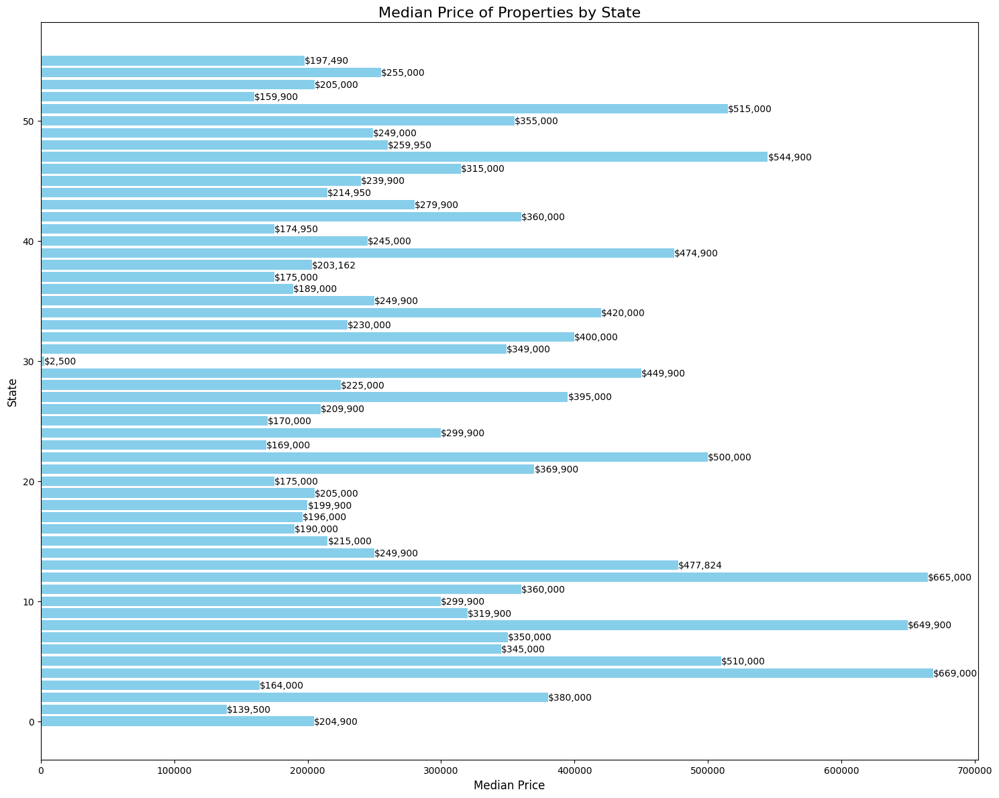

In [50]:
import matplotlib.pyplot as plt

# Set the figure size
plt.figure(figsize=(15, 12))

# Create the horizontal bar plot
bars = plt.barh(state_med_price_sorted['state'], state_med_price_sorted['price'], color='skyblue')

for bar,price in zip(bars,state_med_price_sorted['price']):
    plt.text(bar.get_width() , bar.get_y() + bar.get_height() / 2,f'${price:,.0f}',va='center', ha='left')

# Add labels and title
plt.xlabel('Median Price', fontsize=12)
plt.ylabel('State', fontsize=12)
plt.title('Median Price of Properties by State', fontsize=16)

# Improve layout
plt.tight_layout()

# Display the plot
plt.show()

In [51]:
city_med_price=df.groupby('state')['price'].median().reset_index()
city_med_price_sorted=city_med_price.sort_values(by='price')

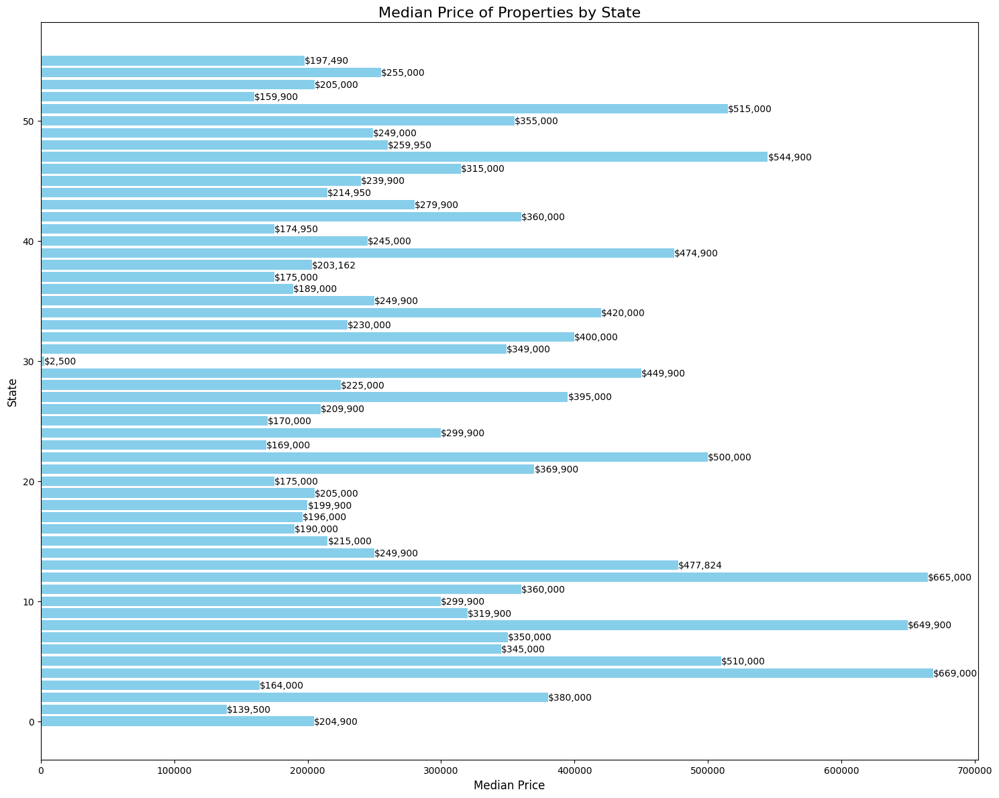

In [52]:
import matplotlib.pyplot as plt

# Set the figure size
plt.figure(figsize=(15, 12))

# Create the horizontal bar plot
bars = plt.barh(city_med_price_sorted['state'], city_med_price_sorted['price'], color='skyblue')

for bar,price in zip(bars,state_med_price_sorted['price']):
    plt.text(bar.get_width() , bar.get_y() + bar.get_height() / 2,f'${price:,.0f}',va='center', ha='left')

# Add labels and title
plt.xlabel('Median Price', fontsize=12)
plt.ylabel('State', fontsize=12)
plt.title('Median Price of Properties by State', fontsize=16)

# Improve layout
plt.tight_layout()

# Display the plot
plt.show()

In [53]:
df.drop(columns = ['prev_sold_date','zip_code','acre_lot'],inplace=True)


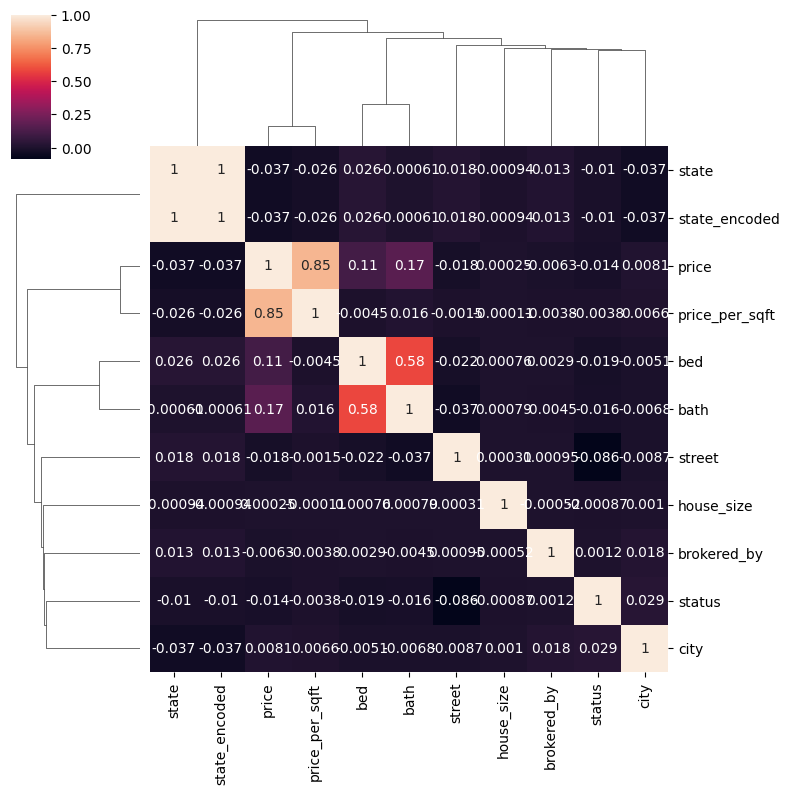

In [54]:
sns.clustermap(
    df.corr(),
    annot=True,
#     cmap='mako',
    figsize=(8, 8)
)
plt.show()

In [55]:
df['price']


,price
0,105000.0
1,80000.0
2,67000.0
3,145000.0
4,65000.0
...,...
2226377,359900.0
2226378,350000.0
2226379,440000.0
2226380,179900.0


<ipython-input-56-9ed3939163ad>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df['price'])


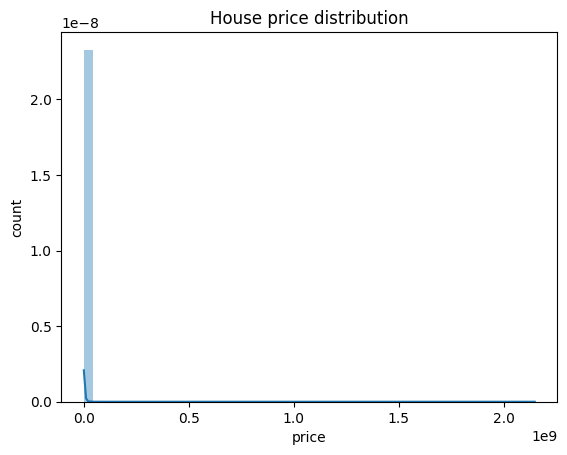

In [56]:
sns.distplot(df['price'])
plt.title('House price distribution')
plt.xlabel('price')
plt.ylabel('count')
plt.show()

In [57]:
import plotly.express as px
fig = px.histogram(df, x='house_size', color='bed', nbins=25, marginal='box',
                   labels={'house_size':'House Size (sqft)'},
                   title='Distribution of House Size with Bed')

fig.show()

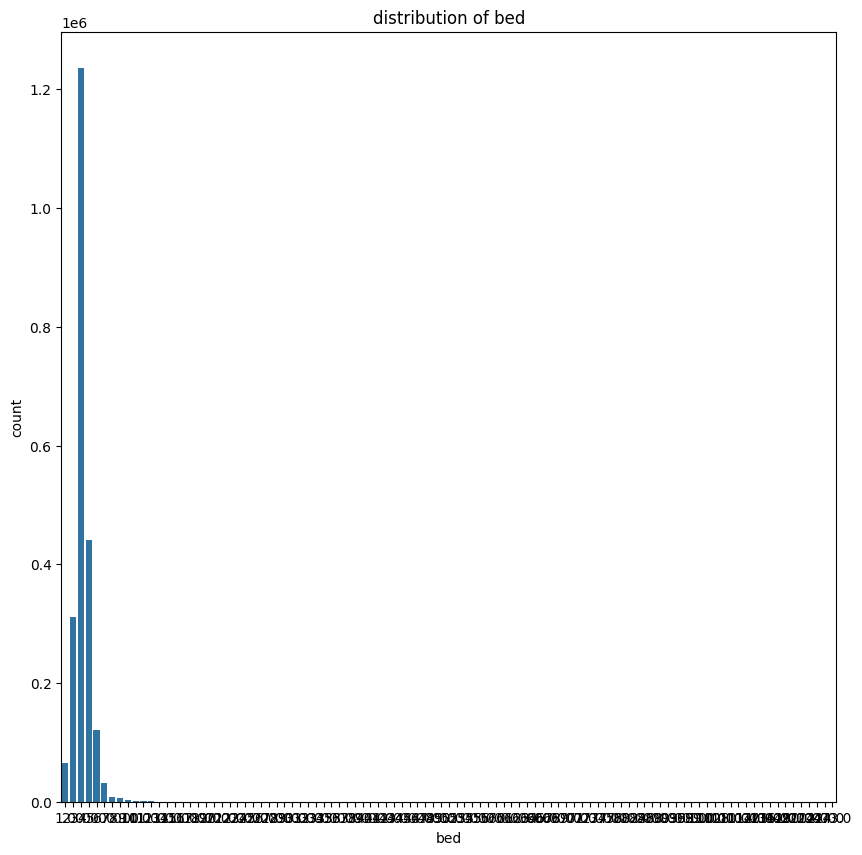

In [59]:
# plt.figure(figsize=(10,10))
# ax = sns.countplot(data=df, x='bed')
# for i in ax.containers:
#   ax.bar_label(i,)
# plt.title('Distribution of Bed', fontsize=18)
# plt.show()


plt.figure(figsize=(10,10))
ax=sns.countplot(data=df,x='bed')
plt.title('distribution of bed')
plt.show()

In [60]:
df['price'].value_counts()


,count
price,
325000.0,15581
350000.0,15430
250000.0,15254
225000.0,13939
450000.0,13213
...,...
344725.0,1
345295.0,1
300355.0,1


In [61]:
df['price'].value_counts()


,count
price,
325000.0,15581
350000.0,15430
250000.0,15254
225000.0,13939
450000.0,13213
...,...
344725.0,1
345295.0,1
300355.0,1


In [64]:
import numpy as np

def outlier_treatment(datacolumn):
    """Function to calculate lower and upper bounds for outlier detection."""
    # Calculate Q1 (25th percentile) and Q3 (75th percentile)
    Q1, Q3 = np.percentile(datacolumn, [40, 60])

    # Compute IQR
    IQR = Q3 - Q1

    # Calculate lower and upper bounds
    lower_bound = Q1 - (1.5 * IQR)
    upper_bound = Q3 + (1.5 * IQR)

    return lower_bound, upper_bound

In [65]:
p,q=outlier_treatment(df['price'])


In [66]:
df.drop(df[ (df['price'] > q) | (df['price'] < p)].index,inplace=True)


In [67]:
print(df['price'])


0          105000.0
1           80000.0
2           67000.0
3          145000.0
4           65000.0
             ...   
2226377    359900.0
2226378    350000.0
2226379    440000.0
2226380    179900.0
2226381    580000.0
Name: price, Length: 1555351, dtype: float64


<ipython-input-68-9ed3939163ad>:1: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




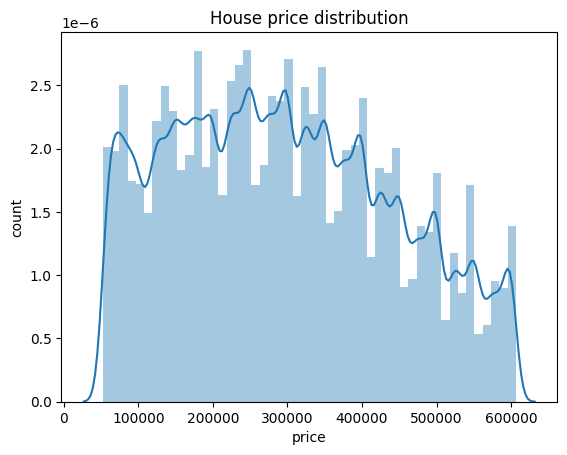

In [68]:
sns.distplot(df['price'])
plt.title('House price distribution')
plt.xlabel('price')
plt.ylabel('count')
plt.show()

In [69]:
# Split the dataset into traning and testing
X = df.iloc[:,0:6].values
y = df.iloc[:,6].values

In [70]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.25,random_state=42)
print((X_train).shape)
print((X_test).shape)
print((y_train).shape)
print((y_test).shape)

(1166513, 6)
(388838, 6)
(1166513,)
(388838,)


In [71]:
# Feature scaling to set all features in single scale
from sklearn.preprocessing import MinMaxScaler
mms = MinMaxScaler()
X_train_scaled = mms.fit_transform(X_train)
X_test_scaled = mms.fit_transform(X_test)

In [72]:
from sklearn.linear_model import LinearRegression
from sklearn.impute import SimpleImputer

# Impute missing values with the mean
imputer = SimpleImputer(strategy='mean')
X_train_scaled = imputer.fit_transform(X_train_scaled)
X_test_scaled = imputer.transform(X_test_scaled)

# Initialize and fit the Linear Regression model
lr_model = LinearRegression()
lr_model.fit(X_train_scaled, y_train)

# Predict on the test set
y_pred_lr = lr_model.predict(X_test_scaled)

In [73]:
from sklearn.metrics import r2_score,mean_squared_error
lr_model_r2 = r2_score(y_test,y_pred_lr)

In [74]:
# R2 score linear Regression
lr_model_r2

0.000708086846199607

In [75]:
# Mean Squared error Linear regression
mse = mean_squared_error(y_test,y_pred_lr)
mse

33080902.11750346